In [1]:
# importing the necessary packages/libraries
import numpy as np
from matplotlib import pyplot as plt
import random

import torch
import torch.nn as nn
import torchvision

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
def random_2d(num_points):
    """"Generates a dataset of 2D points in the range of [-1, 1] with a random label assigned to them."""
    points = np.random.uniform(-1, 1, (num_points, 2))
    labels = np.random.randint(0, 2, num_points)
    return points, labels


def circular_2d(num_points):
    """Generated a dataset of circular 2D points."""
    half_num_pts = num_points // 2
    # Those with label 0 have a radius in the range of [0.1, 0.3]
    # Those with label 1 have a radius in the range of [0.5, 0.7]
    polar_pts = np.array([
        *np.array([np.random.uniform(0.1, 0.3, half_num_pts), np.random.uniform(0, np.pi * 2, half_num_pts)]).T,
        *np.array([np.random.uniform(0.5, 0.7, half_num_pts), np.random.uniform(0, np.pi * 2, half_num_pts)]).T
    ])
    # converting the polar points to cartesian coordinates
    points = np.array([polar_pts[:, 0] * np.sin(polar_pts[:, 1]), polar_pts[:, 0] * np.cos(polar_pts[:, 1])]).T
    labels = np.array([*[0] * half_num_pts, *[1] * half_num_pts])
    return points, labels

def spiral_2d(num_points):
    """Generates a dataset of spiral 2D points."""
    half_num_pts = num_points // 2
    points = []
    labels = []
    # Points with label 0 swirl clockwise.
    for i in range(half_num_pts):
        r = i / half_num_pts * 5
        t = 1.75 * i / half_num_pts * 2 * np.pi + 0
        points.append([r * np.sin(t) + np.random.uniform(-0.1, 0.1), r * np.cos(t) + np.random.uniform(-0.1, 0.1)])
        labels.append(0)
    # Points with label 1 swirl unclockwise.
    for i in range(half_num_pts):
        r = i / half_num_pts * 5
        t = 1.75 * i / half_num_pts * 2 * np.pi + np.pi
        points.append([r * np.sin(t) + np.random.uniform(-0.1, 0.1), r * np.cos(t) + np.random.uniform(-0.1, 0.1)])
        labels.append(1)
    return np.array(points), np.array(labels)

def linear_2d(num_points):
    """Generates a dataset of 2D poins that are linearly seperable."""
    points = np.random.uniform(-1, 1, (num_points, 2))
    # The boundary line.
    line = np.array([[-0.9, -0.7], [1.0, 0.6]])
    # Points with label 0 are above the line and points with label 1 are below the line.
    is_above = lambda p,l: np.cross(p - l[0], l[1] - l[0]) < 0
    labels = []
    for p in points:
        labels.append(0 if is_above(p, line) else 1)
    return points, np.array(labels)

In [4]:
def plot_db(data, title, ax=None):
    points, labels = data
    
    xs = points[:, 0]
    ys = points[:, 1]
    cdict = {0: 'red', 1: 'blue'}

    if ax is None:
        # if axis is not provided create a new figure.
        fig = plt.figure(figsize=(4, 4))
        ax = fig.add_subplot(1, 1, 1)
    for l in np.unique(labels):
        ix = np.where(labels == l)
        ax.scatter(xs[ix], ys[ix], c=cdict[l], label=l, s=10)
    ax.legend()
    ax.set_title(title)
    ax.axis('equal')

In [5]:
number_points = 1000
dbs = {
    'random_data': random_2d(number_points),
    'circular_data': circular_2d(number_points),
    'spiral_data': spiral_2d(number_points),
    'linear_data': linear_2d(number_points)
}

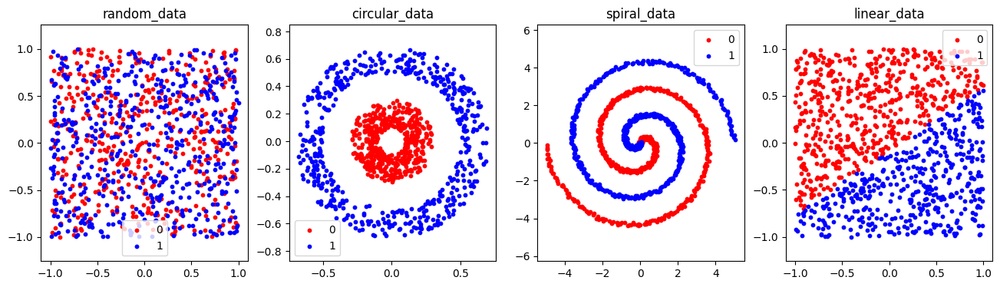

In [6]:
fig = plt.figure(figsize=(16, 4))
for db_ind, (db_key, db_val) in enumerate(dbs.items()):
    ax = fig.add_subplot(1, len(dbs), db_ind+1)
    plot_db(db_val, db_key, ax)

In [7]:
def train_test_split (num_points, datasets):
    train_dbs = dict()
    test_dbs = dict()
    num_tests = num_points // 10
    for db_ind, (db_key, db_val) in enumerate (datasets.items()):
      points, labels  = db_val
      shuffle_inds = np.arange(num_points)
      random.shuffle(shuffle_inds)
      train_dbs[db_key] = points[shuffle_inds[:-num_tests]], labels[shuffle_inds[:-num_tests]]
      test_dbs[db_key] = points[shuffle_inds[-num_tests:]], labels[shuffle_inds[-num_tests:]]
    
    return train_dbs, test_dbs

In [8]:
train_dbs, test_dbs = train_test_split (1000, dbs)

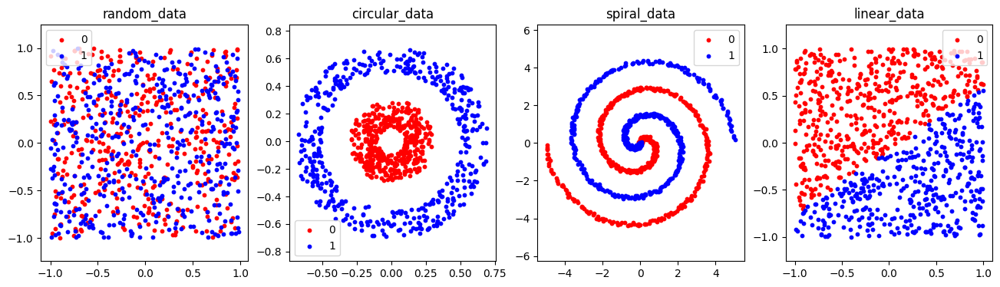

In [10]:
fig = plt.figure(figsize=(16, 4))
for db_ind, (db_key, db_val) in enumerate(train_dbs.items()):
    ax = fig.add_subplot(1, len(train_dbs), db_ind+1)
    plot_db(db_val, db_key, ax)

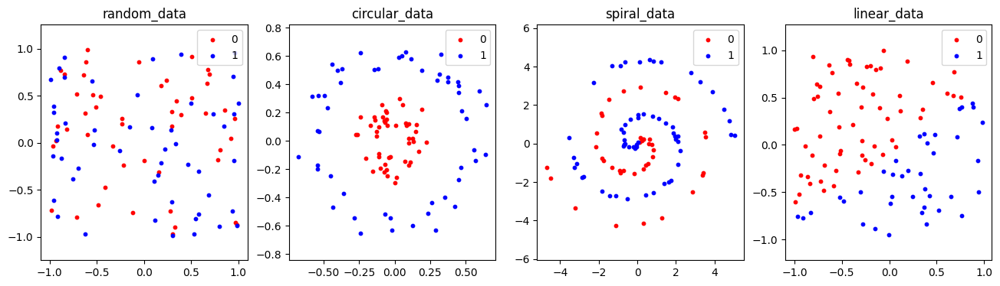

In [11]:
fig = plt.figure(figsize=(16, 4))
for db_ind, (db_key, db_val) in enumerate(test_dbs.items()):
    ax = fig.add_subplot(1, len(test_dbs), db_ind+1)
    plot_db(db_val, db_key, ax)

In [12]:
def accuracy(y_pred, y_true):
    """Calculate accuracy (a classification metric)"""
    correct = torch.eq(y_true, y_pred).sum().item() # torch.eq() calculates where two tensors are equal
    acc = (correct / len(y_pred)) * 100 
    return acc

In [13]:
class Simple2DNetwork(nn.Module):
    def __init__(self, weight_init='uniform', nonlinearity=True):
        super().__init__()
        self.linear1 = nn.Linear(in_features=2, out_features=5) # in_features must be 2 because our data is (x, y).
        self.linear2 = nn.Linear(in_features=5, out_features=1) # out_features equals 1 because of binary classification.
        self.nonlinearity = nonlinearity
        if nonlinearity:
            self.relu = nn.ReLU()
        
        # initialising the weights and their biases
        if weight_init == 'uniform':
            nn.init.uniform_(self.linear1.weight)
            nn.init.uniform_(self.linear2.weight)
        elif weight_init == 'xavier':
            nn.init.xavier_normal_(self.linear1.weight)
            nn.init.xavier_normal_(self.linear2.weight)
    
    # Define a forward method containing the forward pass computation
    # It's common to use the same variable name throughout the forward stream, in this case "x".
    # This is only to simplify coding, input/outpts to all layers would have the same variable name.
    def forward(self, x):
        # The input data is processed by the first linear layer.
        x = self.linear1(x)
        if self.nonlinearity:
            # The output of the first layer is rectified with ReLU.
            x = self.relu(x)
        # The second linear layer produces the output value.
        x = self.linear2(x)
        return x

# Creating an instance of the model and send it to target device
model = Simple2DNetwork().to(device)
print(Simple2DNetwork())

Simple2DNetwork(
  (linear1): Linear(in_features=2, out_features=5, bias=True)
  (linear2): Linear(in_features=5, out_features=1, bias=True)
  (relu): ReLU()
)


In [14]:
def epoch_loop(model, db, criterion, optimiser):
    is_train = False if optimiser is None else True

    model.train() if is_train else model.eval()
    with torch.set_grad_enabled(is_train):
        input_data = torch.tensor(db[0]).float().to(device)
        target = torch.tensor(db[1]).float().to(device)
        prediction = model(input_data)
        prediction = prediction.squeeze()
        
        pred_labels = prediction >= 0.5

        loss = criterion(prediction, target)
        acc = accuracy(pred_labels, target)

        if is_train:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    return acc, loss.item(), target, pred_labels.detach().cpu().numpy()

In [20]:
import os
from google.colab import drive
import matplotlib.pyplot as plt

drive.mount('/content/drive')

def plot_pred_points (database, which_db, gt, predict, epoch):
    points, labels = database [which_db]

    xs = points[:, 0]
    ys = points[:, 1]
    cdict = {0: 'black', 1: 'pink'}
    ground_truth = gt.cpu().numpy().astype(bool)
    c = np.where(ground_truth == predict)

    fig, ax = plt.subplots()

    ax.scatter(xs, ys, color = 'black', label = 'Wrong Points')
    ax.scatter(xs[c], ys[c], color = 'pink', label = 'Right Points')

    ax.legend()
    ax.set_title('Epoch {}'.format (epoch))
    ax.axis('equal')

    directory = '/content/drive/MyDrive/Epochs/'
    os.makedirs (directory, exist_ok=True)

    plt.savefig (directory + 'Epoch {}.png'.format(epoch))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [25]:
model = Simple2DNetwork().to(device)

criterion = nn.L1Loss()

learning_rate = 0.1
optimizer = torch.optim.SGD(params=model.parameters(), lr=learning_rate)

def do_epoch (epochs, train_set, test_set, which_db):
    first_epoch = 0
    print_freq = epochs // 10
    trainlogs = {'acc': [], 'loss':[], 'pred': []}
    vallogs = {'acc': [], 'loss':[], 'pred': []}

    for epoch in range (first_epoch, epochs):
        trainlog = epoch_loop (model, train_set[which_db], criterion, optimizer)
        vallog = epoch_loop (model, test_set[which_db], criterion, None)

        plot_pred_points (test_set, which_db, vallog [2], vallog [3], epoch)

        if np.mod (epoch, print_freq) == 0:
         print('[%.2d] Train     loss=%.4f     acc=%0.2f    [%.2d] Test     loss=%.4f     acc=%0.2f' % 
              (
                  epoch, np.mean(trainlog[1]), np.mean(trainlog[0]),
                  epoch, np.mean(vallog[1]), np.mean(vallog[0])
              ))
         trainlogs['acc'].append(np.mean(trainlog[0]))
         trainlogs['loss'].append(np.mean(trainlog[1]))
         trainlogs['pred'].append(trainlog[3])
         vallogs['acc'].append(np.mean(vallog[0]))
         vallogs['loss'].append(np.mean(vallog[1]))
         vallogs['pred'].append(vallog[3])

    return trainlogs, vallogs

In [26]:
trainlogs, vallogs = do_epoch (1000, train_dbs, test_dbs, 'circular_data')

[00] Train     loss=0.4597     acc=57.67    [00] Test     loss=0.4087     acc=70.00
[100] Train     loss=0.3513     acc=66.33    [100] Test     loss=0.3253     acc=71.00
[200] Train     loss=0.2720     acc=75.00    [200] Test     loss=0.2494     acc=79.00
[300] Train     loss=0.1860     acc=98.56    [300] Test     loss=0.1837     acc=97.00
[400] Train     loss=0.1967     acc=98.89    [400] Test     loss=0.2170     acc=94.00
[500] Train     loss=0.1976     acc=98.56    [500] Test     loss=0.2250     acc=95.00
[600] Train     loss=0.1991     acc=98.67    [600] Test     loss=0.2260     acc=95.00
[700] Train     loss=0.1972     acc=98.78    [700] Test     loss=0.2105     acc=96.00
[800] Train     loss=0.1955     acc=98.78    [800] Test     loss=0.2065     acc=96.00
[900] Train     loss=0.1939     acc=98.78    [900] Test     loss=0.2198     acc=96.00


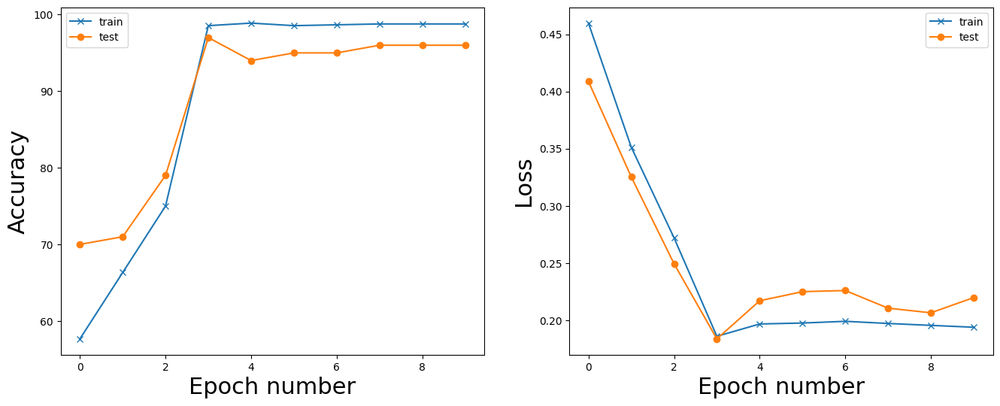

In [27]:
fig = plt.figure(figsize=(16, 6))
ax = fig.add_subplot(1, 2, 1)
ax.plot(trainlogs['acc'], '-x', label='train')
ax.plot(vallogs['acc'], '-o', label='test')
ax.set_ylabel('Accuracy', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

ax = fig.add_subplot(1, 2, 2)
ax.plot(trainlogs['loss'], '-x', label='train')
ax.plot(vallogs['loss'], '-o', label='test')
ax.set_ylabel('Loss', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

In [30]:
import imageio.v2 as imageio

filenames_names = sorted(os.listdir('/content/drive/MyDrive/Epochs/'), key=lambda x: int(x.split('Epoch ')[1].split('.png')[0]) if 'Epoch ' in x and '.png' in x else -1)

c_imgs = [imageio.imread(os.path.join('/content/drive/MyDrive/Epochs/', file)) for file in filenames_names if file.endswith('.png')]
imageio.mimsave('/content/drive/MyDrive/Epochs/animation.gif', c_imgs, fps=40)

You can find the pictures and gif here:
https://drive.google.com/drive/u/0/folders/1aOJBUdC6AuUEV8lkC8QhcMFvNqva4srb

In [32]:
def do_epoch (epochs, train_set, test_set, which_db):
    first_epoch = 0
    print_freq = epoch // 10
    trainlogs = {'acc': [], 'loss':[], 'predict': []}
    vallogs = {'acc': [], 'loss':[], 'predict': []}

    for epoch in range (first_epoch, epochs):
        trainlog = epoch_loop (model, train_set[which_db], criterion, optimizer)
        vallog = epoch_loop (model, test_set[which_db], criterion, None)

        if np.mod (epoch, print_freq):
         print('[%.2d] Train     loss=%.4f     acc=%0.2f    [%.2d] Test     loss=%.4f     acc=%0.2f' % 
              (
                  epoch, np.mean(trainlog[1]), np.mean(trainlog[0]),
                  epoch, np.mean(vallog[1]), np.mean(vallog[0])
              ))
         trainlogs['acc'].append(np.mean(trainlog[0]))
         trainlogs['loss'].append(np.mean(trainlog[1]))
         trainlogs['pred'].append(trainlog[3])
         vallogs['acc'].append(np.mean(vallog[0]))
         vallogs['loss'].append(np.mean(vallog[1]))
         vallogs['pred'].append(vallog[3])

    return trainlogs, vallogs

## **Exercise 2**

In [50]:
def plotweights (epoch):
    layers = [model.linear1, model.linear2]

    for i in range (len (layers)):
        fig, ax = plt.subplots(figsize =(5, 5))
        ax.matshow (layers [i].weight.detach().cpu().numpy(), cmap = 'gray')
        

        directory = ('/content/drive/MyDrive/Layer %d/'% (i + 1))
        os.makedirs (directory, exist_ok=True)
        plt.savefig (directory + ('Epoch %d.png' % epoch))

In [56]:
def do_epoch (epochs, train_set, test_set, which_db):
    first_epoch = 0
    print_freq = epochs // 10
    trainlogs = {'acc': [], 'loss':[], 'pred': []}
    vallogs = {'acc': [], 'loss':[], 'pred': []}

    for epoch in range (first_epoch, epochs):
        trainlog = epoch_loop (model, train_set[which_db], criterion, optimizer)
        vallog = epoch_loop (model, test_set[which_db], criterion, None)

        plotweights (epoch)
        
        if np.mod (epoch, print_freq) == 0:
         print('[%.2d] Train     loss=%.4f     acc=%0.2f    [%.2d] Test     loss=%.4f     acc=%0.2f' % 
              (
                  epoch, np.mean(trainlog[1]), np.mean(trainlog[0]),
                  epoch, np.mean(vallog[1]), np.mean(vallog[0])
              ))
         trainlogs['acc'].append(np.mean(trainlog[0]))
         trainlogs['loss'].append(np.mean(trainlog[1]))
         trainlogs['pred'].append(trainlog[3])
         vallogs['acc'].append(np.mean(vallog[0]))
         vallogs['loss'].append(np.mean(vallog[1]))
         vallogs['pred'].append(vallog[3])

    return trainlogs, vallogs

[00] Train     loss=2.9813     acc=50.56    [00] Test     loss=1.2841     acc=53.00


<ipython-input-50-0bf448dc9d05>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize =(5, 5))


[100] Train     loss=0.5269     acc=49.11    [100] Test     loss=0.6024     acc=63.00
[200] Train     loss=0.4823     acc=51.89    [200] Test     loss=0.4733     acc=50.00
[300] Train     loss=0.4579     acc=52.00    [300] Test     loss=0.4711     acc=49.00
[400] Train     loss=0.4445     acc=57.22    [400] Test     loss=0.4759     acc=50.00
[500] Train     loss=0.4503     acc=56.44    [500] Test     loss=0.5560     acc=39.00
[600] Train     loss=0.4454     acc=52.11    [600] Test     loss=0.4821     acc=46.00
[700] Train     loss=0.4156     acc=55.11    [700] Test     loss=0.4531     acc=53.00
[800] Train     loss=0.4088     acc=58.56    [800] Test     loss=0.4328     acc=63.00
[900] Train     loss=0.4069     acc=61.22    [900] Test     loss=0.4312     acc=65.00


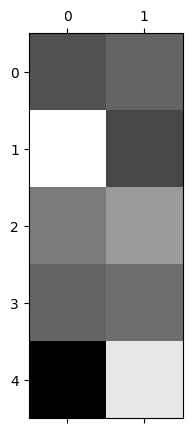

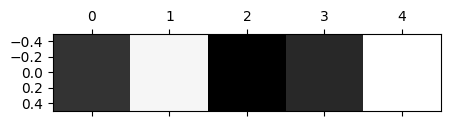

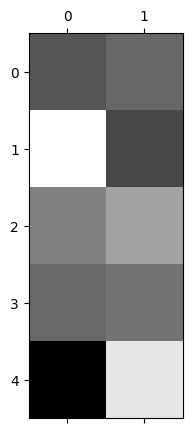

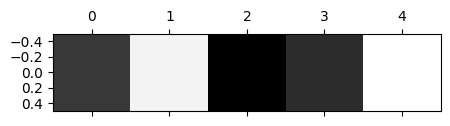

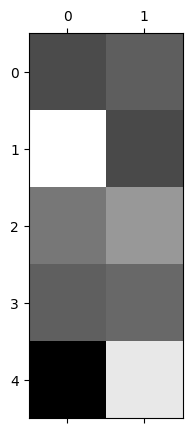

...

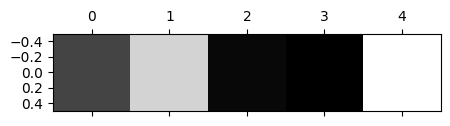

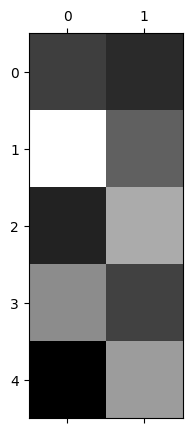

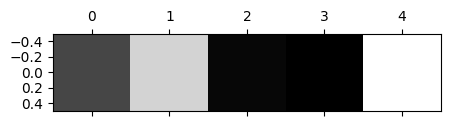

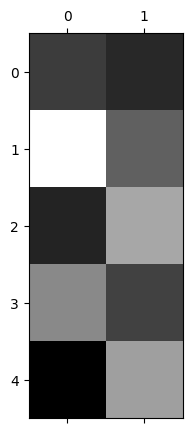

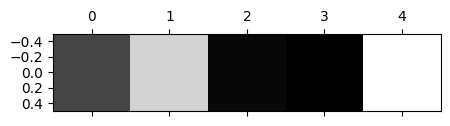

In [58]:
trainlogs, vallogs = do_epoch(1000, train_dbs, test_dbs, 'spiral_data')

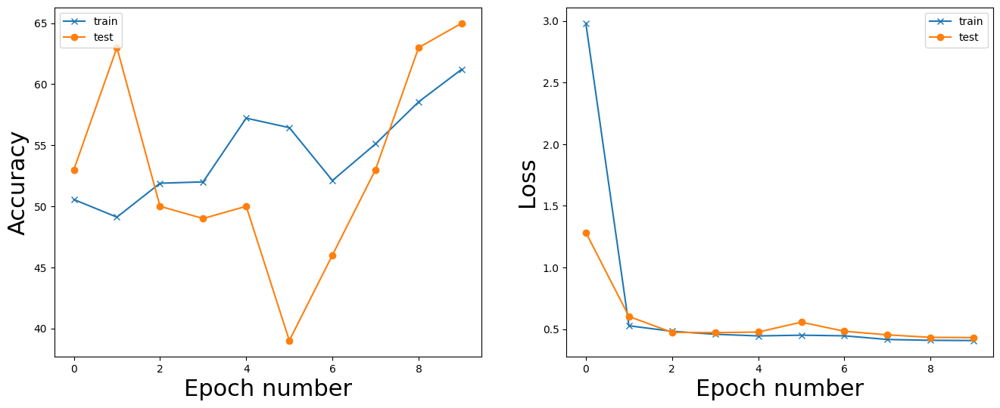

In [59]:
fig = plt.figure(figsize=(16, 6))
ax = fig.add_subplot(1, 2, 1)
ax.plot(trainlogs['acc'], '-x', label='train')
ax.plot(vallogs['acc'], '-o', label='test')
ax.set_ylabel('Accuracy', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

ax = fig.add_subplot(1, 2, 2)
ax.plot(trainlogs['loss'], '-x', label='train')
ax.plot(vallogs['loss'], '-o', label='test')
ax.set_ylabel('Loss', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

In [65]:
for i in ["1", "2"]: 
    imagefiles = sorted (os.listdir('/content/drive/MyDrive/Layer %s/'% i), key = lambda x: int(x.split('Epoch ')[1].split('.png')[0]) if 'Epoch ' in x and '.png' in x else -1)

    c_imgs = [imageio.imread(os.path.join('/content/drive/MyDrive/Layer %s/'% i, file)) for file in imagefiles if file.endswith('.png')]
    imageio.mimsave(('/content/drive/MyDrive/Layer %s/animation.gif'% i), c_imgs, fps=40)

In [66]:
def plotweights (epoch):
    layers = [model.linear1, model.linear2]

    for i in range (len (layers)):
        fig, ax = plt.subplots(figsize =(5, 5))
        ax.matshow (layers [i].weight.detach().cpu().numpy(), cmap = 'gray')
        

        directory = ('/content/drive/MyDrive/SLRLayer %d/'% (i + 1))
        os.makedirs (directory, exist_ok=True)
        plt.savefig (directory + ('Epoch %d.png' % epoch))

In [67]:
# For learning rate smaller than 1

learning_rate = 0.05
optimizer = torch.optim.SGD(params=model.parameters(), lr=learning_rate)

def do_epoch (epochs, train_set, test_set, which_db):
    first_epoch = 0
    print_freq = epochs // 10
    trainlogs = {'acc': [], 'loss':[], 'pred': []}
    vallogs = {'acc': [], 'loss':[], 'pred': []}

    for epoch in range (first_epoch, epochs):
        trainlog = epoch_loop (model, train_set[which_db], criterion, optimizer)
        vallog = epoch_loop (model, test_set[which_db], criterion, None)

        plotweights (epoch)
        
        if np.mod (epoch, print_freq) == 0:
         print('[%.2d] Train     loss=%.4f     acc=%0.2f    [%.2d] Test     loss=%.4f     acc=%0.2f' % 
              (
                  epoch, np.mean(trainlog[1]), np.mean(trainlog[0]),
                  epoch, np.mean(vallog[1]), np.mean(vallog[0])
              ))
         trainlogs['acc'].append(np.mean(trainlog[0]))
         trainlogs['loss'].append(np.mean(trainlog[1]))
         trainlogs['pred'].append(trainlog[3])
         vallogs['acc'].append(np.mean(vallog[0]))
         vallogs['loss'].append(np.mean(vallog[1]))
         vallogs['pred'].append(vallog[3])

    return trainlogs, vallogs

[00] Train     loss=0.5329     acc=47.11    [00] Test     loss=0.5411     acc=46.00


<ipython-input-66-513125f3d765>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize =(5, 5))


[100] Train     loss=0.4227     acc=59.33    [100] Test     loss=0.4240     acc=59.00
[200] Train     loss=0.3582     acc=66.33    [200] Test     loss=0.3509     acc=66.00
[300] Train     loss=0.3314     acc=70.22    [300] Test     loss=0.3301     acc=69.00
[400] Train     loss=0.3047     acc=78.89    [400] Test     loss=0.3073     acc=77.00
[500] Train     loss=0.2794     acc=82.22    [500] Test     loss=0.2844     acc=79.00
[600] Train     loss=0.2712     acc=82.22    [600] Test     loss=0.2769     acc=80.00
[700] Train     loss=0.2676     acc=83.22    [700] Test     loss=0.2714     acc=80.00
[800] Train     loss=0.2649     acc=83.22    [800] Test     loss=0.2673     acc=81.00
[900] Train     loss=0.2629     acc=83.56    [900] Test     loss=0.2643     acc=82.00


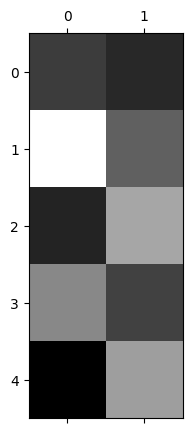

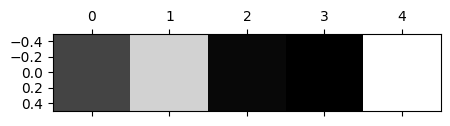

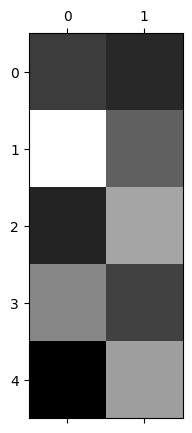

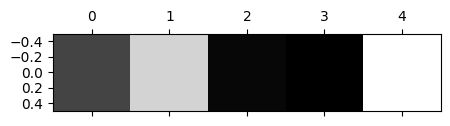

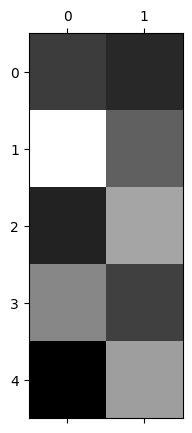

...

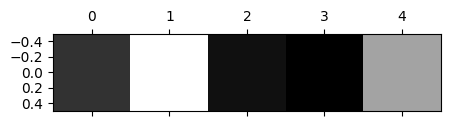

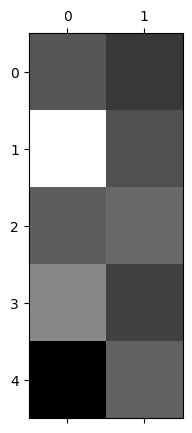

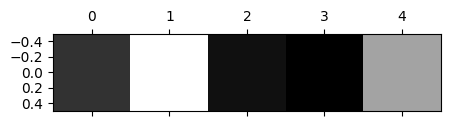

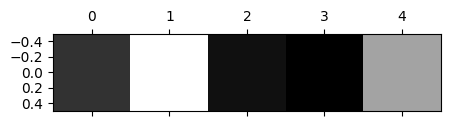

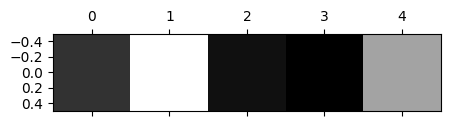

In [68]:
trainlogs, vallogs = do_epoch (1000, train_dbs, test_dbs, 'circular_data')

In [69]:
for i in ["1", "2"]: 
    imagefiles = sorted (os.listdir('/content/drive/MyDrive/SLRLayer %s/'% i), key = lambda x: int(x.split('Epoch ')[1].split('.png')[0]) if 'Epoch ' in x and '.png' in x else -1)

    c_imgs = [imageio.imread(os.path.join('/content/drive/MyDrive/SLRLayer %s/'% i, file)) for file in imagefiles if file.endswith('.png')]
    imageio.mimsave(('/content/drive/MyDrive/SLRLayer %s/animation.gif'% i), c_imgs, fps=40)

The smaller rate is here: 
https://drive.google.com/drive/u/0/folders/1-8KBSJzEDl_PuheKyH3kZWZ6Pp_2VDet
https://drive.google.com/drive/u/0/folders/1-Dn-d-Ut3VI7NmuqQ5gZJTaFSz_KBOyj

In [70]:
fig = plt.figure(figsize=(16, 6))
ax = fig.add_subplot(1, 2, 1)
ax.plot(trainlogs['acc'], '-x', label='train')
ax.plot(vallogs['acc'], '-o', label='test')
ax.set_ylabel('Accuracy', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

ax = fig.add_subplot(1, 2, 2)
ax.plot(trainlogs['loss'], '-x', label='train')
ax.plot(vallogs['loss'], '-o', label='test')
ax.set_ylabel('Loss', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

Due to the slower learning rate we can see that the performance is slower as the slope is smoother.

## **Exercise 3** 

In [77]:
# Bonus Exercise / Two for-loops avoided

def spiral_2d(num_points, swirlprob = 0.5):
    points = []
    labels = []
    outliers = int(num_points * 5/100)

    for i in range(num_points):
        s = 1 if np.random.rand() > swirlprob else 0
        r = i / num_points * 5
        t = 1.75 * i / num_points * 2 * np.pi + (np.pi * s)
        points.append([r * np.sin(t) + np.random.uniform(-0.1, 0.1), r * np.cos(t) + np.random.uniform(-0.1, 0.1)])
        labels.append(s)

    shuffle_inds = np.arange(num_points)
    random.shuffle (shuffle_inds)
    outlier_inds = np.where(shuffle_inds < outliers) [0]
    points_np = np.array (points)

    for i in outlier_inds:
        points_np [shuffle_inds [i]] = [np.random.randint (-4, 4), np.random.randint (-4,4)]

    return points_np, np.array (labels)

In [78]:
number_points = 1000
data_base = {'spiral data': spiral_2d (1000)}

In [81]:
train_dbs, test_dbs = train_test_split (number_points, data_base)

In [85]:
fig = plt.figure(figsize=(16, 4))
for db_ind, (db_key, db_val) in enumerate(train_dbs.items()):
    ax = fig.add_subplot(1, len(train_dbs), db_ind+1)
    plot_db(db_val, db_key, ax)

In [86]:
fig = plt.figure(figsize=(16, 4))
for db_ind, (db_key, db_val) in enumerate(test_dbs.items()):
    ax = fig.add_subplot(1, len(test_dbs), db_ind+1)
    plot_db(db_val, db_key, ax)

In [87]:
model = Simple2DNetwork().to(device)

criterion =  nn.SmoothL1Loss()

'''losses = {
    'L1': nn.L1Loss(reduction='none'),
    'MSE': nn.MSELoss(reduction='none'),
    'SmoothL1': nn.SmoothL1Loss(reduction='none'),
    'Huber': nn.HuberLoss(reduction='none', delta=0.6),
    'BCELoss': nn.BCELoss(reduction='none'),
}'''

learning_rate = 0.1
optimizer = torch.optim.SGD(params=model.parameters(), lr=learning_rate)

def do_epoch (epochs, train_set, test_set, which_db):
    first_epoch = 0
    print_freq = epochs // 10
    trainlogs = {'acc': [], 'loss':[], 'pred': []}
    vallogs = {'acc': [], 'loss':[], 'pred': []}

    for epoch in range (first_epoch, epochs):
        trainlog = epoch_loop (model, train_set[which_db], criterion, optimizer)
        vallog = epoch_loop (model, test_set[which_db], criterion, None)

        if np.mod (epoch, print_freq) == 0:
         print('[%.2d] Train     loss=%.4f     acc=%0.2f    [%.2d] Test     loss=%.4f     acc=%0.2f' % 
              (
                  epoch, np.mean(trainlog[1]), np.mean(trainlog[0]),
                  epoch, np.mean(vallog[1]), np.mean(vallog[0])
              ))
         trainlogs['acc'].append(np.mean(trainlog[0]))
         trainlogs['loss'].append(np.mean(trainlog[1]))
         trainlogs['pred'].append(trainlog[3])
         vallogs['acc'].append(np.mean(vallog[0]))
         vallogs['loss'].append(np.mean(vallog[1]))
         vallogs['pred'].append(vallog[3])

    return trainlogs, vallogs

In [89]:
trainlogs, vallogs = do_epoch (1000, train_dbs, test_dbs, which_db = 'spiral data')

[00] Train     loss=0.7223     acc=51.11    [00] Test     loss=0.3704     acc=52.00
[100] Train     loss=0.1180     acc=60.22    [100] Test     loss=0.1283     acc=52.00
[200] Train     loss=0.1163     acc=61.56    [200] Test     loss=0.1258     acc=58.00
[300] Train     loss=0.1152     acc=62.11    [300] Test     loss=0.1247     acc=57.00
[400] Train     loss=0.1144     acc=62.11    [400] Test     loss=0.1240     acc=56.00
[500] Train     loss=0.1139     acc=62.89    [500] Test     loss=0.1236     acc=56.00
[600] Train     loss=0.1136     acc=63.33    [600] Test     loss=0.1235     acc=59.00
[700] Train     loss=0.1134     acc=63.33    [700] Test     loss=0.1235     acc=60.00
[800] Train     loss=0.1132     acc=63.11    [800] Test     loss=0.1236     acc=59.00
[900] Train     loss=0.1131     acc=62.78    [900] Test     loss=0.1236     acc=59.00


In [90]:
fig = plt.figure(figsize=(16, 6))
ax = fig.add_subplot(1, 2, 1)
ax.plot(trainlogs['acc'], '-x', label='train')
ax.plot(vallogs['acc'], '-o', label='test')
ax.set_ylabel('Accuracy', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

ax = fig.add_subplot(1, 2, 2)
ax.plot(trainlogs['loss'], '-x', label='train')
ax.plot(vallogs['loss'], '-o', label='test')
ax.set_ylabel('Loss', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

As we can see, the model cannot increase the performance without the outliers.

## **Exercise 4**

In [ ]:
def epoch_loop (model, db, criterion, optimizer):
    is_train = False if optimizer is None else True

    model.train() if is_train else model.eval()
    with torch.set_grad_enabled(is_train):
        input_data = torch.tensor(db[0]).float().to(device)
        target = torch.tensor(db[1]).float().to(device)
        prediction = model(input_data)
        prediction = prediction.squeeze()
        
        pred_labels = prediction >= 0.5

        loss = criterion(prediction, target)
        acc = accuracy(pred_labels, target)

        if is_train:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

    return acc, loss.item(), target, pred_labels.detach().cpu().numpy()

In [108]:
model = Simple2DNetwork().to(device)
criterion =  nn.SmoothL1Loss()
learning_rate = 0.1

def do_epoch (epochs, train_set, test_set, optimizer_string, lr, which_db):
    
    if optimizer_string == 'SGD':
        optimizer = torch.optim.SGD (model.parameters(), lr)
    elif optimizer_string == 'RMSprop':
        optimizer = torch.optim.RMSprop (model.parameters(), lr)
    elif optimizer_string == 'AdaGrad':
        optimizer = torch.optim.AdaGrad (model.parameters(), lr)
    else:
        raise ValueError ('Optimizer Name Invalid')

    first_epoch = 0
    print_freq = epochs // 10
    trainlogs = {'acc': [], 'loss':[], 'pred': []}
    vallogs = {'acc': [], 'loss':[], 'pred': []}

    for epoch in range (first_epoch, epochs):
        trainlog = epoch_loop (model, train_set[which_db], criterion, optimizer)
        vallog = epoch_loop (model, test_set[which_db], criterion, None)

        if np.mod (epoch, print_freq) == 0:
         print('[%.2d] Train     loss=%.4f     acc=%0.2f    [%.2d] Test     loss=%.4f     acc=%0.2f' % 
              (
                  epoch, np.mean(trainlog[1]), np.mean(trainlog[0]),
                  epoch, np.mean(vallog[1]), np.mean(vallog[0])
              ))
         trainlogs['acc'].append(np.mean(trainlog[0]))
         trainlogs['loss'].append(np.mean(trainlog[1]))
         trainlogs['pred'].append(trainlog[3])
         vallogs['acc'].append(np.mean(vallog[0]))
         vallogs['loss'].append(np.mean(vallog[1]))
         vallogs['pred'].append(vallog[3])

    return trainlogs, vallogs

In [109]:
trainlogs, vallogs = do_epoch (1000, train_dbs, test_dbs, 'RMSprop', 0.1, 'spiral data')

[00] Train     loss=2.1950     acc=52.78    [00] Test     loss=1.7709     acc=49.00
[100] Train     loss=2.1950     acc=52.78    [100] Test     loss=1.7709     acc=49.00
[200] Train     loss=2.1950     acc=52.78    [200] Test     loss=1.7709     acc=49.00
[300] Train     loss=2.1950     acc=52.78    [300] Test     loss=1.7709     acc=49.00
[400] Train     loss=2.1950     acc=52.78    [400] Test     loss=1.7709     acc=49.00
[500] Train     loss=2.1950     acc=52.78    [500] Test     loss=1.7709     acc=49.00
[600] Train     loss=2.1950     acc=52.78    [600] Test     loss=1.7709     acc=49.00
[700] Train     loss=2.1950     acc=52.78    [700] Test     loss=1.7709     acc=49.00
[800] Train     loss=2.1950     acc=52.78    [800] Test     loss=1.7709     acc=49.00
[900] Train     loss=2.1950     acc=52.78    [900] Test     loss=1.7709     acc=49.00


In [110]:
fig = plt.figure(figsize=(16, 6))
ax = fig.add_subplot(1, 2, 1)
ax.plot(trainlogs['acc'], '-x', label='train')
ax.plot(vallogs['acc'], '-o', label='test')
ax.set_ylabel('Accuracy', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

ax = fig.add_subplot(1, 2, 2)
ax.plot(trainlogs['loss'], '-x', label='train')
ax.plot(vallogs['loss'], '-o', label='test')
ax.set_ylabel('Loss', size=22)
ax.set_xlabel('Epoch number', size=22)
ax.legend()

The optimizer does not fit thus the model cannot learn.